In [1]:
%matplotlib inline
import numpy as np
from matplotlib import pyplot
from matplotlib import rcParams

In [2]:
dx = 0.01
dt = 0.0025
Lx = 1
Lt = 4 # time limit
Nx = int(Lx / dx)
Nt = int(Lt / dt)
U = np.zeros([Nt, Nx], dtype = float)
a = 0.1
U[:, 0] = 1
#U[:, -1] = 0

In [3]:
# main calculation cycle
# U[n + 1, i] = U[n, i] + dt * (a / dx)^2 * (U[n, i + 1] - 2U[n, i] + U[n, i - 1])
for n in range(0, Nt - 1):
    U[n + 1, 1:-1] = U[n, 1:-1] + (U[n, 2:] - 2. * U[n, 1:-1] + U[n, :-2]) * dt * a * a / dx / dx
    U[n + 1, -2] = U[n + 1, -1]

In [4]:
from matplotlib import animation
from IPython.display import HTML

In [5]:
def animate(data):
    x = np.linspace(0, 1, Nx)
    y = data
    line.set_data(x, y)
    return line

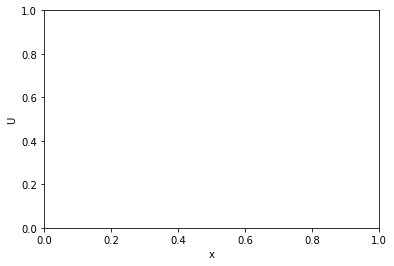

In [6]:
fig = pyplot.figure();
ax = pyplot.axes(xlim = (0, 1),
                 ylim = (0, 1),
                 xlabel = ('x'),
                 ylabel = ('U'));
line, = ax.plot([], [], '-', color = '#003366', lw = 2);

In [7]:
rcParams['animation.embed_limit'] = 128
anim = animation.FuncAnimation(fig, animate, frames = U, interval = 50)
HTML(anim.to_jshtml())